### Imports

In [493]:
import torch
import pandas as pd, numpy as np
import matplotlib.pyplot as plt
import os, gc
import cv2
import time

### Load Train Data

In [20]:
df = pd.read_csv('../data/train.csv')
TARGETS = df.columns[-6:]
print('Train shape:', df.shape )
print('Targets', list(TARGETS))
df.head()

Train shape: (106800, 15)
Targets ['seizure_vote', 'lpd_vote', 'gpd_vote', 'lrda_vote', 'grda_vote', 'other_vote']


,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
0,1628180742,0,0.0,353733,0,0.0,127492639,42516,Seizure,3,0,0,0,0,0
1,1628180742,1,6.0,353733,1,6.0,3887563113,42516,Seizure,3,0,0,0,0,0
2,1628180742,2,8.0,353733,2,8.0,1142670488,42516,Seizure,3,0,0,0,0,0
3,1628180742,3,18.0,353733,3,18.0,2718991173,42516,Seizure,3,0,0,0,0,0
4,1628180742,4,24.0,353733,4,24.0,3080632009,42516,Seizure,3,0,0,0,0,0


### Create Non-Overlapping Eeg Id Train Data

The competition data description says that test data does not have multiple crops from the same eeg_id. Therefore we will train and validate using only 1 crop per eeg_id.

In [21]:
# Associate spectrogram id with eeg id and add minimum coresponding offset
train = df.groupby('eeg_id')[['spectrogram_id','spectrogram_label_offset_seconds']].agg(
    {'spectrogram_id':'first','spectrogram_label_offset_seconds':'min'})
train.columns = ['spec_id','min']
train.head()

,spec_id,min
eeg_id,,
568657,789577333,0.0
582999,1552638400,0.0
642382,14960202,1008.0
751790,618728447,908.0
778705,52296320,0.0


In [22]:
# Add maximum corresponding offset
tmp = df.groupby('eeg_id')[['spectrogram_id','spectrogram_label_offset_seconds']].agg(
    {'spectrogram_label_offset_seconds':'max'})
train['max'] = tmp
train.head()

,spec_id,min,max
eeg_id,,,
568657,789577333,0.0,16.0
582999,1552638400,0.0,38.0
642382,14960202,1008.0,1032.0
751790,618728447,908.0,908.0
778705,52296320,0.0,0.0


In [23]:
# Associate eeg id to patient id
tmp = df.groupby('eeg_id')[['patient_id']].agg('first')
train['patient_id'] = tmp
train.head()

,spec_id,min,max,patient_id
eeg_id,,,,
568657,789577333,0.0,16.0,20654
582999,1552638400,0.0,38.0,20230
642382,14960202,1008.0,1032.0,5955
751790,618728447,908.0,908.0,38549
778705,52296320,0.0,0.0,40955


In [24]:
# Add votes to corresponding eeg id
tmp = df.groupby('eeg_id')[TARGETS].agg('sum')
for t in TARGETS:
    train[t] = tmp[t].values
    
train.head()

,spec_id,min,max,patient_id,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
eeg_id,,,,,,,,,,
568657,789577333,0.0,16.0,20654,0,0,12,0,8,28
582999,1552638400,0.0,38.0,20230,0,132,0,11,0,11
642382,14960202,1008.0,1032.0,5955,0,0,0,0,0,2
751790,618728447,908.0,908.0,38549,0,0,1,0,0,0
778705,52296320,0.0,0.0,40955,0,0,0,0,0,2


In [25]:
# Transform number of votes to probs
y_data = train[TARGETS].values
y_data = y_data / y_data.sum(axis=1,keepdims=True)
train[TARGETS] = y_data
train.head()

,spec_id,min,max,patient_id,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
eeg_id,,,,,,,,,,
568657,789577333,0.0,16.0,20654,0.0,0.000000,0.25,0.000000,0.166667,0.583333
582999,1552638400,0.0,38.0,20230,0.0,0.857143,0.00,0.071429,0.000000,0.071429
642382,14960202,1008.0,1032.0,5955,0.0,0.000000,0.00,0.000000,0.000000,1.000000
751790,618728447,908.0,908.0,38549,0.0,0.000000,1.00,0.000000,0.000000,0.000000
778705,52296320,0.0,0.0,40955,0.0,0.000000,0.00,0.000000,0.000000,1.000000


In [26]:
# Convert probs into the target diagnosis
tmp = df.groupby('eeg_id')[['expert_consensus']].agg('first')
train['target'] = tmp
train.head()

,spec_id,min,max,patient_id,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote,target
eeg_id,,,,,,,,,,,
568657,789577333,0.0,16.0,20654,0.0,0.000000,0.25,0.000000,0.166667,0.583333,Other
582999,1552638400,0.0,38.0,20230,0.0,0.857143,0.00,0.071429,0.000000,0.071429,LPD
642382,14960202,1008.0,1032.0,5955,0.0,0.000000,0.00,0.000000,0.000000,1.000000,Other
751790,618728447,908.0,908.0,38549,0.0,0.000000,1.00,0.000000,0.000000,0.000000,GPD
778705,52296320,0.0,0.0,40955,0.0,0.000000,0.00,0.000000,0.000000,1.000000,Other


In [27]:
# Add index to have the training csv
train = train.reset_index()
print('Train non-overlapp eeg_id shape:', train.shape )
train.head()

Train non-overlapp eeg_id shape: (17089, 12)


,eeg_id,spec_id,min,max,patient_id,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote,target
0,568657,789577333,0.0,16.0,20654,0.0,0.000000,0.25,0.000000,0.166667,0.583333,Other
1,582999,1552638400,0.0,38.0,20230,0.0,0.857143,0.00,0.071429,0.000000,0.071429,LPD
2,642382,14960202,1008.0,1032.0,5955,0.0,0.000000,0.00,0.000000,0.000000,1.000000,Other
3,751790,618728447,908.0,908.0,38549,0.0,0.000000,1.00,0.000000,0.000000,0.000000,GPD
4,778705,52296320,0.0,0.0,40955,0.0,0.000000,0.00,0.000000,0.000000,1.000000,Other


### Read the training spectrograms from Kaggle

~ 10 mins from kaggle dataset

~ 1 min from [custom dataset](https://www.kaggle.com/datasets/cdeotte/brain-spectrograms)

In [30]:
%%time
READ_SPEC_FILES = True

# READ ALL SPECTROGRAMS
PATH = '../data/train_spectrograms/'
files = os.listdir(PATH)
print(f'There are {len(files)} spectrogram parquets')

if READ_SPEC_FILES:    
    spectrograms = {}
    for i,f in enumerate(files):
        if i%100==0: print(i,', ',end='')
        tmp = pd.read_parquet(f'{PATH}{f}')
        name = int(f.split('.')[0])
        spectrograms[name] = tmp.iloc[:,1:].values
else:
    spectrograms = np.load('../data/brain-spectrograms/specs.npy',allow_pickle=True).item()

There are 11138 spectrogram parquets
0 , 100 , 200 , 300 , 400 , 500 , 600 , 700 , 800 , 900 , 1000 , 1100 , 1200 , 1300 , 1400 , 1500 , 1600 , 1700 , 1800 , 1900 , 2000 , 2100 , 2200 , 2300 , 2400 , 2500 , 2600 , 2700 , 2800 , 2900 , 3000 , 3100 , 3200 , 3300 , 3400 , 3500 , 3600 , 3700 , 3800 , 3900 , 4000 , 4100 , 4200 , 4300 , 4400 , 4500 , 4600 , 4700 , 4800 , 4900 , 5000 , 5100 , 5200 , 5300 , 5400 , 5500 , 5600 , 5700 , 5800 , 5900 , 6000 , 6100 , 6200 , 6300 , 6400 , 6500 , 6600 , 6700 , 6800 , 6900 , 7000 , 7100 , 7200 , 7300 , 7400 , 7500 , 7600 , 7700 , 7800 , 7900 , 8000 , 8100 , 8200 , 8300 , 8400 , 8500 , 8600 , 8700 , 8800 , 8900 , 9000 , 9100 , 9200 , 9300 , 9400 , 9500 , 9600 , 9700 , 9800 , 9900 , 10000 , 10100 , 10200 , 10300 , 10400 , 10500 , 10600 , 10700 , 10800 , 10900 , 11000 , 11100 , CPU times: user 9min 8s, sys: 6.83 s, total: 9min 15s
Wall time: 9min 18s


### Read EEG Spectrograms
 
 Using [computed spectrograms](https://www.kaggle.com/code/cdeotte/how-to-make-spectrogram-from-eeg) from eegs

In [33]:
%%time
READ_EEG_SPEC_FILES = True

if READ_EEG_SPEC_FILES:
    all_eegs = {}
    for i,e in enumerate(train.eeg_id.values):
        if i%100==0: print(i,', ',end='')
        x = np.load(f'../data/EEG_Spectrograms/{e}.npy')
        all_eegs[e] = x
else:
    all_eegs = np.load('../data/brain-eeg-spectrograms/eeg_specs.npy',allow_pickle=True).item()

0 , 100 , 200 , 300 , 400 , 500 , 600 , 700 , 800 , 900 , 1000 , 1100 , 1200 , 1300 , 1400 , 1500 , 1600 , 1700 , 1800 , 1900 , 2000 , 2100 , 2200 , 2300 , 2400 , 2500 , 2600 , 2700 , 2800 , 2900 , 3000 , 3100 , 3200 , 3300 , 3400 , 3500 , 3600 , 3700 , 3800 , 3900 , 4000 , 4100 , 4200 , 4300 , 4400 , 4500 , 4600 , 4700 , 4800 , 4900 , 5000 , 5100 , 5200 , 5300 , 5400 , 5500 , 5600 , 5700 , 5800 , 5900 , 6000 , 6100 , 6200 , 6300 , 6400 , 6500 , 6600 , 6700 , 6800 , 6900 , 7000 , 7100 , 7200 , 7300 , 7400 , 7500 , 7600 , 7700 , 7800 , 7900 , 8000 , 8100 , 8200 , 8300 , 8400 , 8500 , 8600 , 8700 , 8800 , 8900 , 9000 , 9100 , 9200 , 9300 , 9400 , 9500 , 9600 , 9700 , 9800 , 9900 , 10000 , 10100 , 10200 , 10300 , 10400 , 10500 , 10600 , 10700 , 10800 , 10900 , 11000 , 11100 , 11200 , 11300 , 11400 , 11500 , 11600 , 11700 , 11800 , 11900 , 12000 , 12100 , 12200 , 12300 , 12400 , 12500 , 12600 , 12700 , 12800 , 12900 , 13000 , 13100 , 13200 , 13300 , 13400 , 13500 , 13600 , 13700 , 13800 , 

### Train DataLoader

Dataloader outputs both Kaggle spectrograms and EEG spectrogams as 8 channel image of size 128x256x8.

In [771]:
import albumentations as albu
from torch.utils.data import Dataset, DataLoader

TARS = {'Seizure':0, 'LPD':1, 'GPD':2, 'LRDA':3, 'GRDA':4, 'Other':5}
TARS2 = {x:y for y,x in TARS.items()}

In [772]:
class DataGenerator(Dataset):
    'Generates data for Keras'
    def __init__(self, data, shuffle=False, augment=False, mode='train',
                 specs = spectrograms, eeg_specs = all_eegs): 

        self.data = data
        self.augment = augment
        self.mode = mode
        self.specs = specs
        self.eeg_specs = eeg_specs
        
    def __len__(self):
        return len(self.data) 
    
    def __getitem__(self, index):
        'Generate one batch of data'
        X, y = self.__data_generation(index)
        if self.augment: X = self.__random_transform(X) 
        return X, y
                        
    def __data_generation(self, index):
        'Generates data containing batch_size samples' 
        
        X = np.zeros((128,256,8),dtype='float32')
        y = np.zeros((6),dtype='float32')
        img = np.ones((128,256),dtype='float32')
        
        row = self.data.iloc[index]
        if self.mode=='test': 
            r = 0
        else: 
            r = int( (row['min'] + row['max'])//4 )

        for k in range(4):
            # EXTRACT 300 ROWS OF SPECTROGRAM
            img = self.specs[row.spec_id][r:r+300,k*100:(k+1)*100].T

            # LOG TRANSFORM SPECTROGRAM
            img = np.clip(img,np.exp(-4),np.exp(8))
            img = np.log(img)

            # STANDARDIZE PER IMAGE
            ep = 1e-6
            m = np.nanmean(img.flatten())
            s = np.nanstd(img.flatten())
            img = (img-m)/(s+ep)
            img = np.nan_to_num(img, nan=0.0)

            # CROP TO 256 TIME STEPS
            X[14:-14,:,k] = img[:,22:-22] / 2.0

        # EEG SPECTROGRAMS
        img = self.eeg_specs[row.eeg_id]
        X[:,:,4:] = img

        if self.mode!='test':
            y = row[TARGETS]
            
        return X,np.array(y).astype(np.float32)
    
    def __random_transform(self, img):
        composition = albu.Compose([
            albu.HorizontalFlip(p=0.5),
        ])
        return composition(image=img)['image']
            

In [773]:
train_dataset = DataGenerator(train, augment=False)
train_dataloader = DataLoader(train_dataset, batch_size=32, shuffle=False)


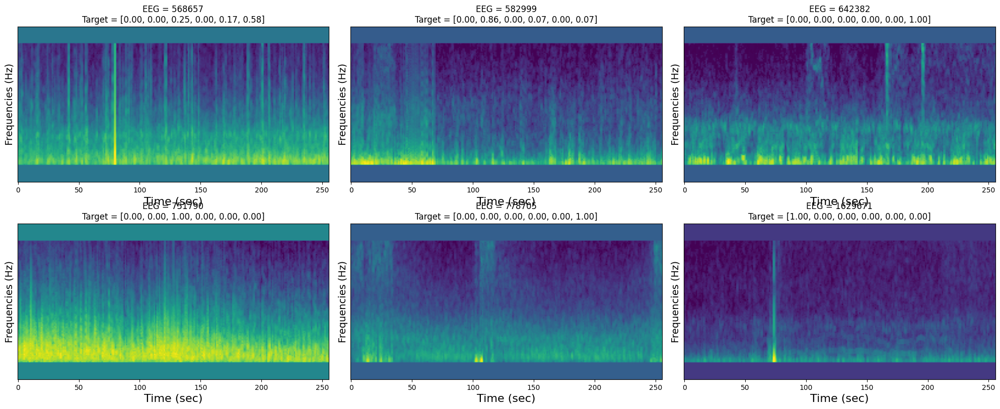

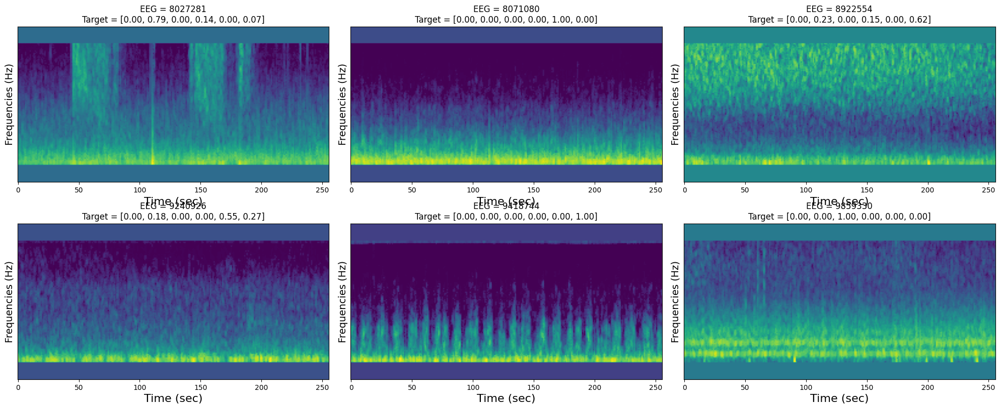

In [774]:
# Constants
ROWS = 2 # Define number of rows here
COLS = 3 # Define number of columns here
BATCHES = 2 # Define number of batches here

# Processing the dataloader
for i, (x, y) in enumerate(train_dataloader):
    if i >= BATCHES:
        break

    # Initialize figure and subplots
    fig, axes = plt.subplots(ROWS, COLS, figsize=(20, 8))
    axes = axes.flatten()  # Flatten for easy indexing

    for j in range(ROWS):
        for k in range(COLS):
            ax = axes[j * COLS + k]

            t = y[j * COLS + k]
            eeg = train.eeg_id.values[i * 32 + j * COLS + k]

            img = x[j * COLS + k, :, :, 0].flip(0)
            mn = img.flatten().min()
            mx = img.flatten().max()
            img = (img - mn) / (mx - mn)

            ax.imshow(img)

            # Format the target string
            tars = f'[{t[0]:0.2f}'
            for s in t[1:]:
                tars += f', {s:0.2f}'
            tars += ']'

            ax.set_title(f'EEG = {eeg}\nTarget = {tars}', size=12)
            ax.set_yticks([])
            ax.set_ylabel('Frequencies (Hz)', size=14)
            ax.set_xlabel('Time (sec)', size=16)

    # Hide any unused subplots
    for ax in axes[len(x):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

### Data augmentation process

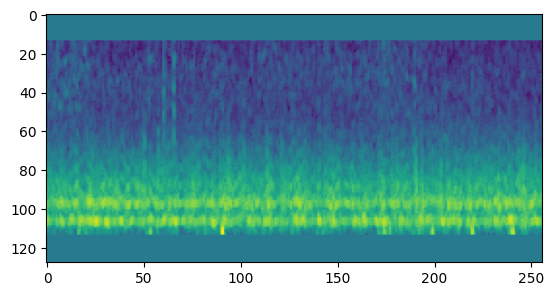

In [775]:
### Original image

plt.imshow(img)
plt.show()

In [776]:
def grid_plot(function, img):
    
    fig, axs = plt.subplots(5, 3, figsize=(20, 20))

    for i in range(5): 
        
        for j in range(3): 
            
            axs[i, j].imshow(function(img))
            axs[i, j].axis('off') 

    plt.show()

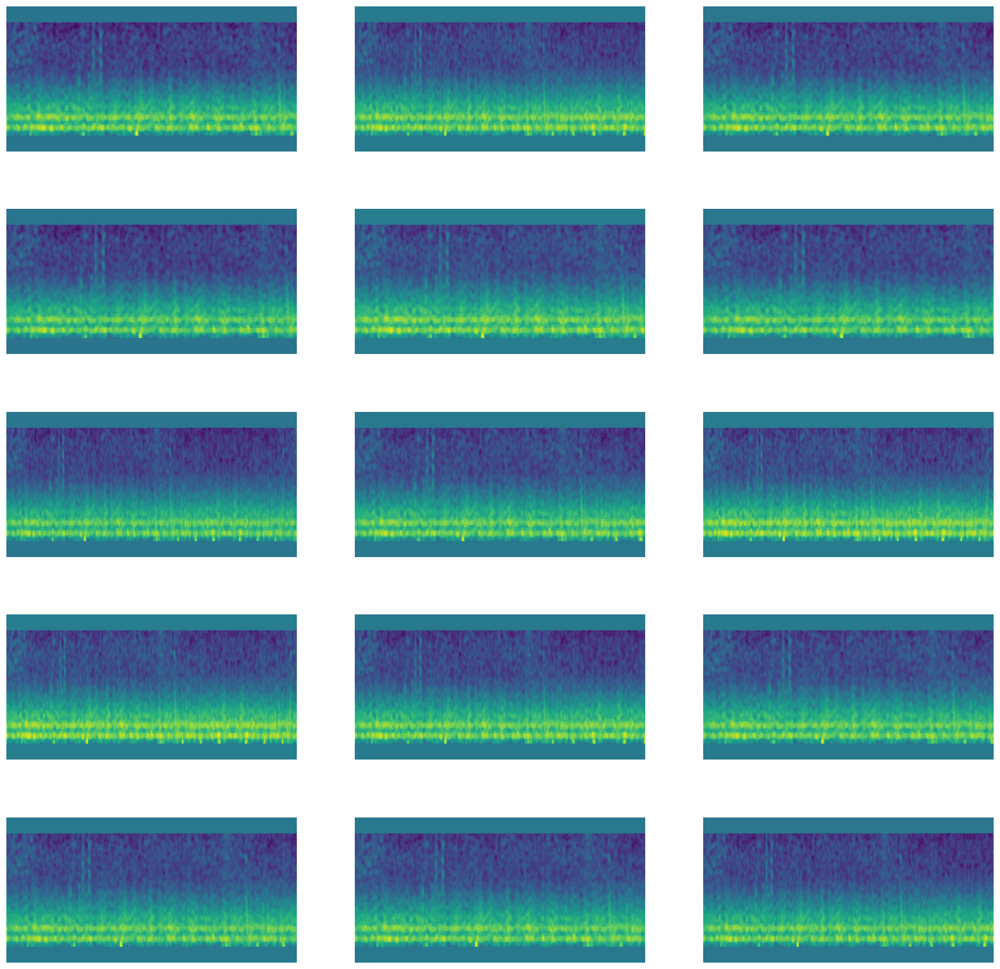

In [778]:
### Time warping

import scipy.ndimage

def time_warp(spectrogram, scale=0.7,p = 1.0):  
    
    if random.random() > p:
        return spectrogram
    
    scale_time = np.random.uniform(scale, 1/scale)
    warp_mat = np.array(([scale_time,0,0],[0,1,0]))
    warped_spectrogram = cv2.warpAffine(spectrogram, warp_mat, (spectrogram.shape[1], spectrogram.shape[0]),borderMode=cv2.BORDER_REFLECT)
    return warped_spectrogram
    
    
grid_plot(time_warp, img.numpy())

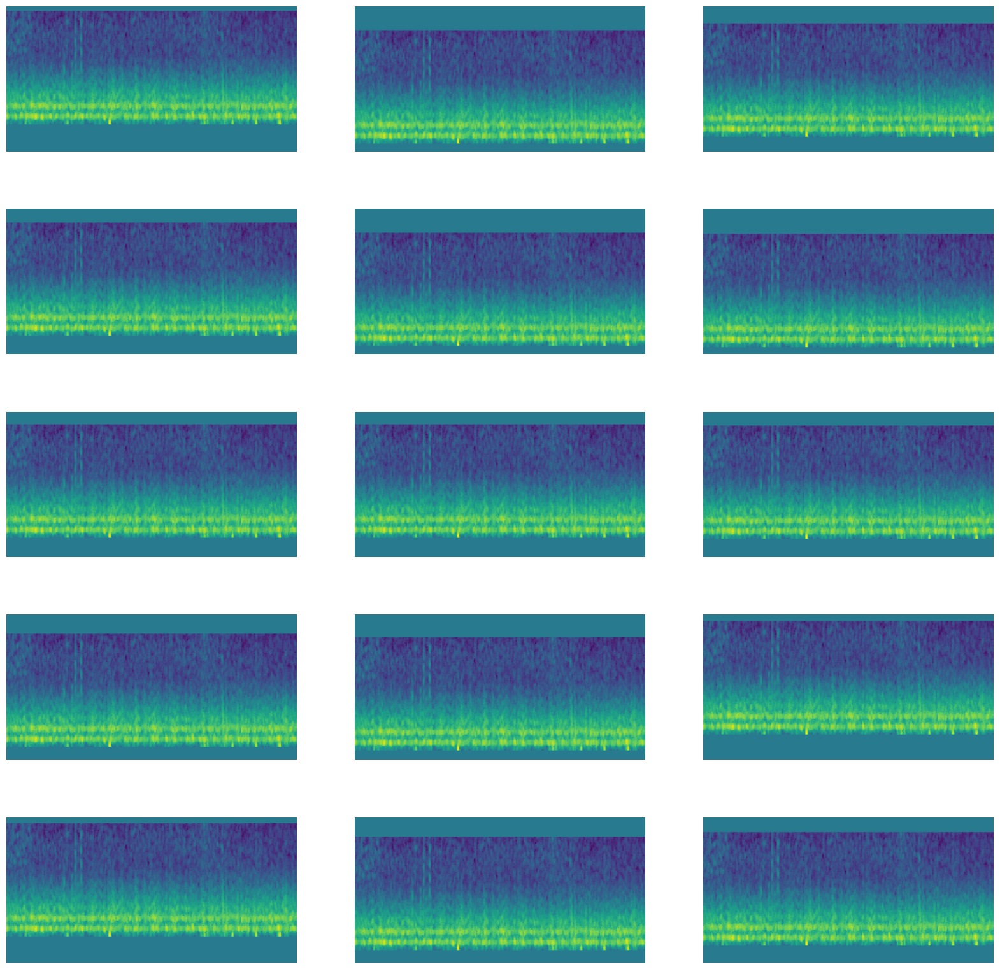

In [779]:
### Frequency Shifting

def frequency_shift(spectrogram, shift_max=0.1,p=1.0):
    if random.random() > p:
        return spectrogram
    shift = np.random.uniform(-shift_max, shift_max) * spectrogram.shape[0]
    return np.roll(spectrogram, int(shift), axis=0)

grid_plot(frequency_shift, img.numpy())

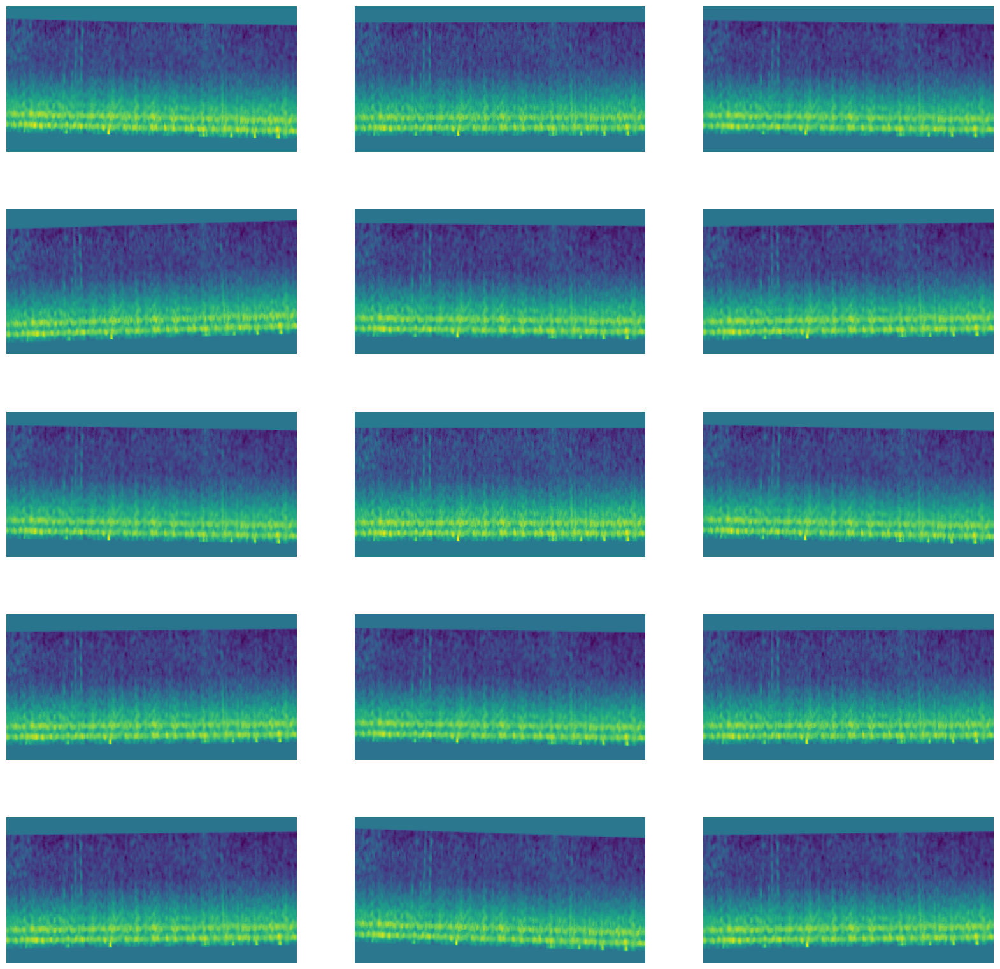

In [780]:
### Rotation

def rotate_spectrogram(spectrogram, angle_limit=2,p=1.0):
    augmenter = albu.Rotate(limit=angle_limit, p=p)
    return augmenter(image=spectrogram)['image']

grid_plot(rotate_spectrogram, img.numpy())


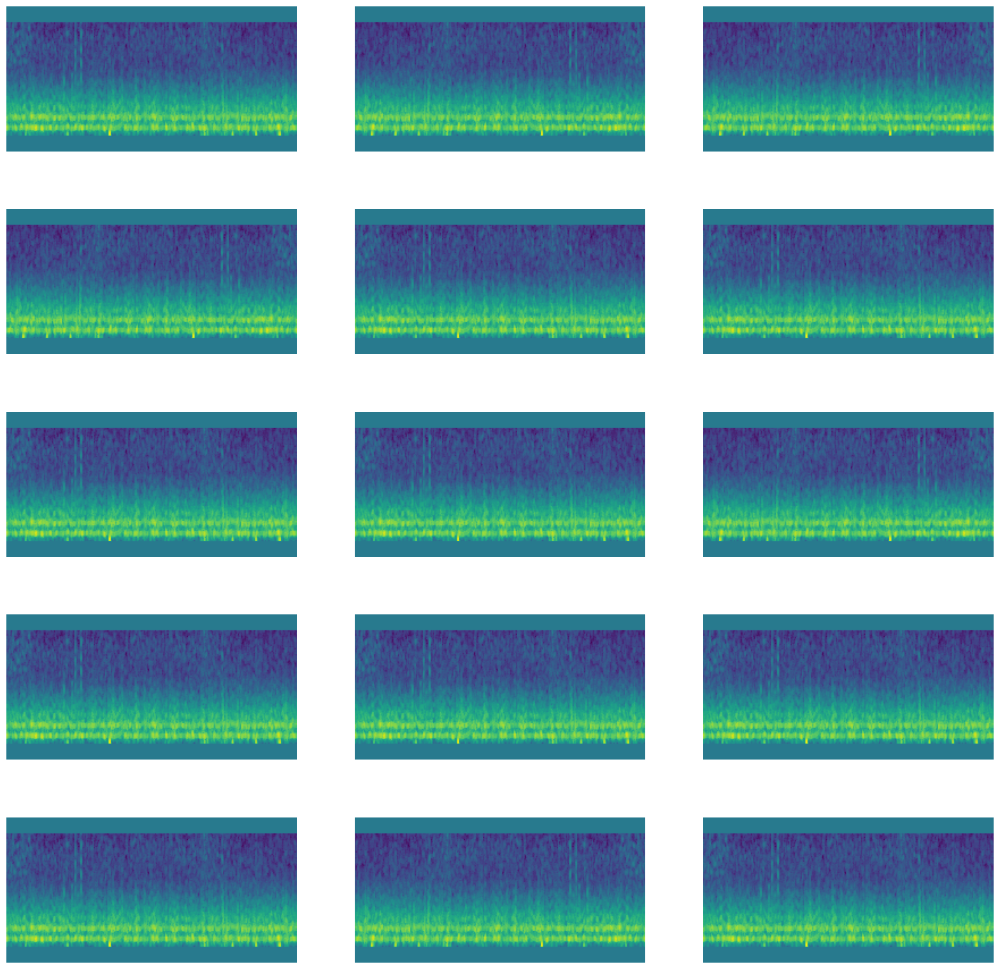

In [781]:
### Horizontal flipping

def horizontal_flip(spectrogram, p=0.5):
    if random.random() > p:
        return spectrogram
    return albu.HorizontalFlip(p=p)(image = spectrogram)['image']


grid_plot(horizontal_flip, img.numpy())

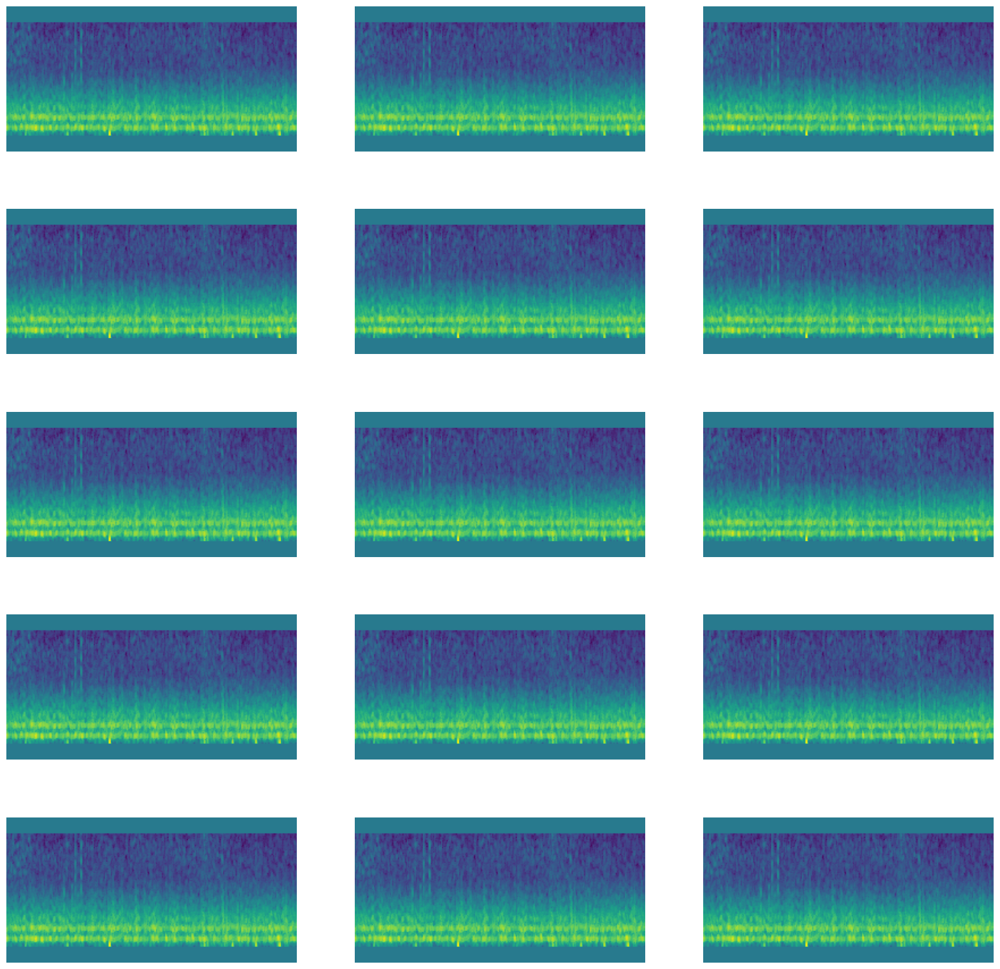

In [782]:
### Scaling

def scale_amplitude(spectrogram, scale_factor_range=(0.8, 1.2),p=1.0):
    if random.random() > p:
        return spectrogram
    
    scale_factor = np.random.uniform(*scale_factor_range)
    return spectrogram * scale_factor

grid_plot(scale_amplitude, img.numpy())

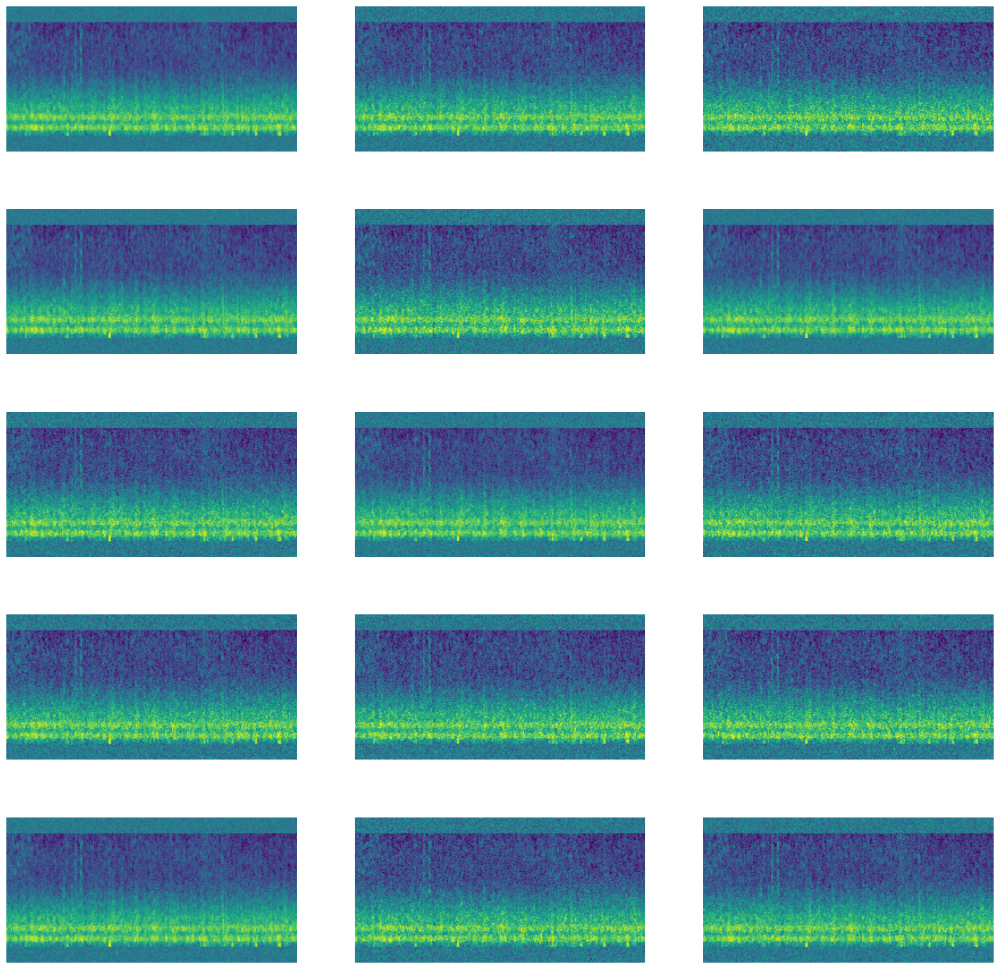

In [783]:
### Noise injection

def add_noise(spectrogram, noise_var=0.01,p=1.0):
    augmenter = albu.GaussNoise(var_limit=(0, noise_var), p=p)
    return augmenter(image=spectrogram)['image']

grid_plot(add_noise, img.numpy())

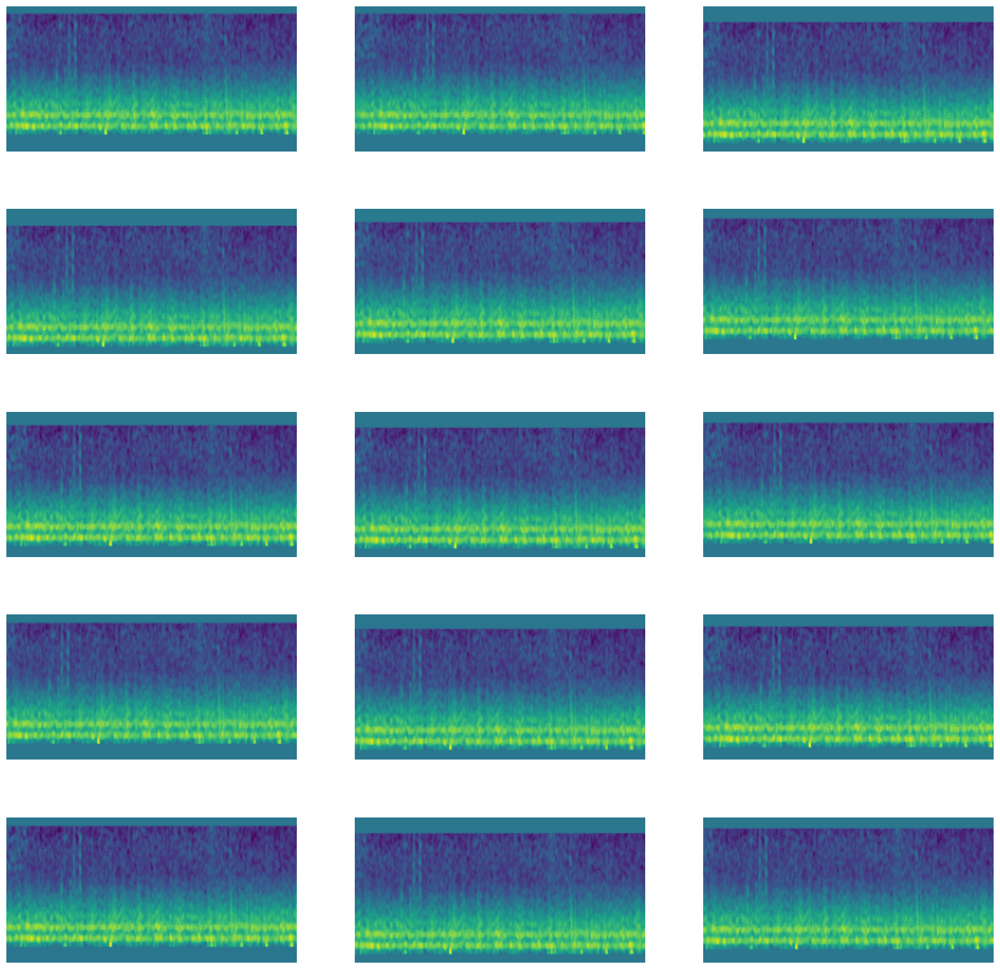

In [784]:
### Random Cropping

def random_crop(spectrogram, crop_height=120, crop_width=240, p=1.0):
    augmenter = albu.RandomCrop(height=crop_height, width=crop_width, p=p)
    return cv2.resize(augmenter(image=spectrogram)['image'],(256,128))

grid_plot(random_crop,img.numpy())

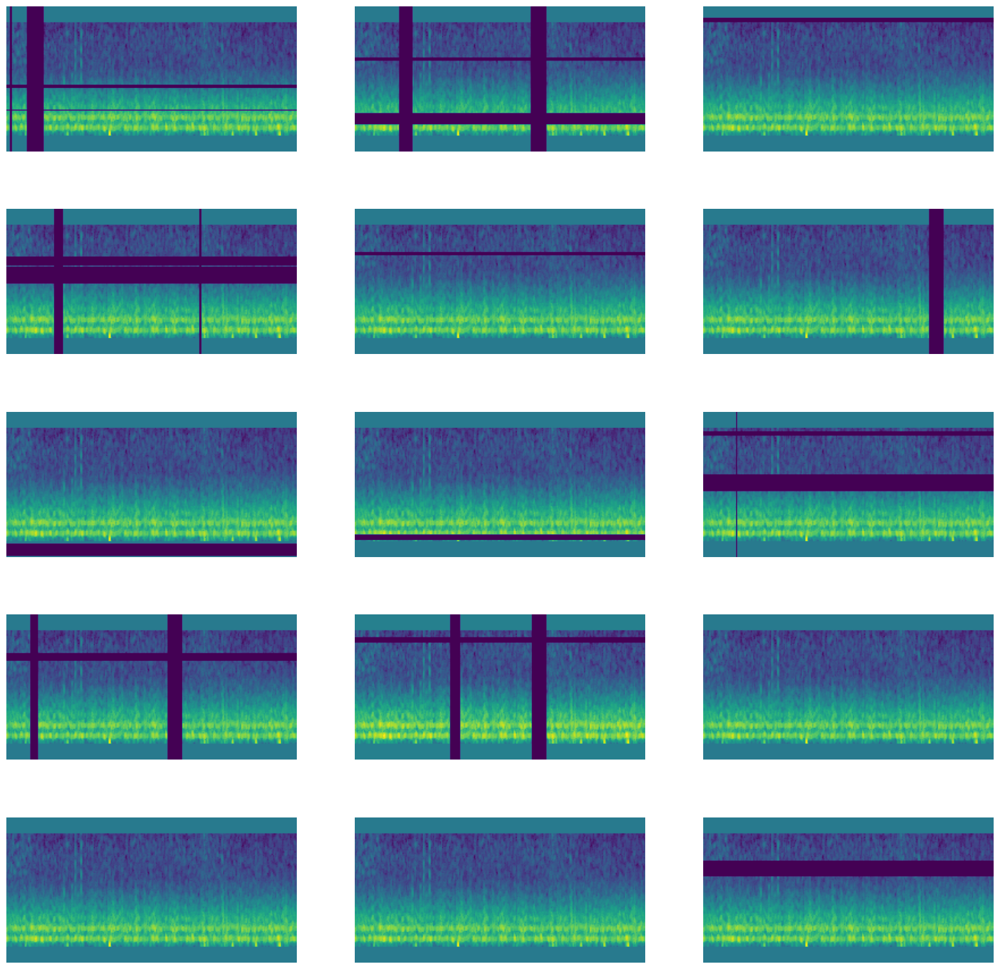

In [785]:
### Time and Frequency Masking

def mask_time_frequency(spectrogram, min_mask_size=0, max_mask_size=15, min_num_masks=0, max_num_masks=2, p=1.0):
    if random.random() > p:
        return spectrogram
    
    augmented = spectrogram.copy()
    
    num_time_masks = np.random.randint(min_num_masks, max_num_masks + 1)

    for _ in range(num_time_masks):
        mask_size_time = np.random.randint(min_mask_size, max_mask_size + 1)
        time_mask_start = np.random.randint(0, spectrogram.shape[1] - mask_size_time)
        augmented[:, time_mask_start:time_mask_start + mask_size_time] = 0

    num_freq_masks = np.random.randint(min_num_masks, max_num_masks + 1)

    for _ in range(num_freq_masks):
        mask_size_freq = np.random.randint(min_mask_size, max_mask_size + 1)
        freq_mask_start = np.random.randint(0, spectrogram.shape[0] - mask_size_freq)
        augmented[freq_mask_start:freq_mask_start + mask_size_freq, :] = 0

    return augmented

grid_plot(mask_time_frequency,img.numpy())

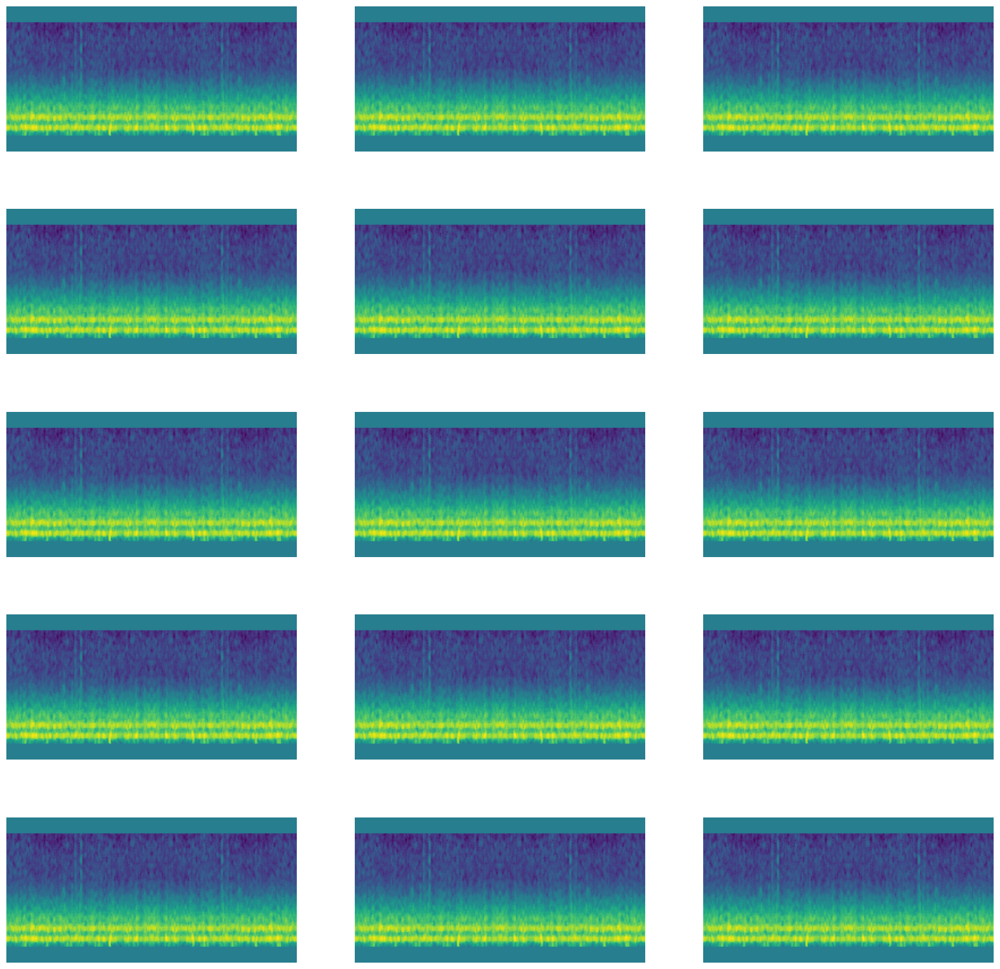

In [786]:
### Mixup

aug = albu.HorizontalFlip(p=1)
img_flip = aug(image = img.numpy())['image']

def mixup_spectrogram(spectrogram1, spectrogram2=img_flip, alpha=1.0,p=1.0):
    if random.random() > p:
        return spectrogram
    lam = np.clip(np.random.beta(alpha, alpha), 0.4, 0.6)
    return mix_ratio * spectrogram1 + (1 - mix_ratio) * spectrogram2


grid_plot(mixup_spectrogram,img.numpy())

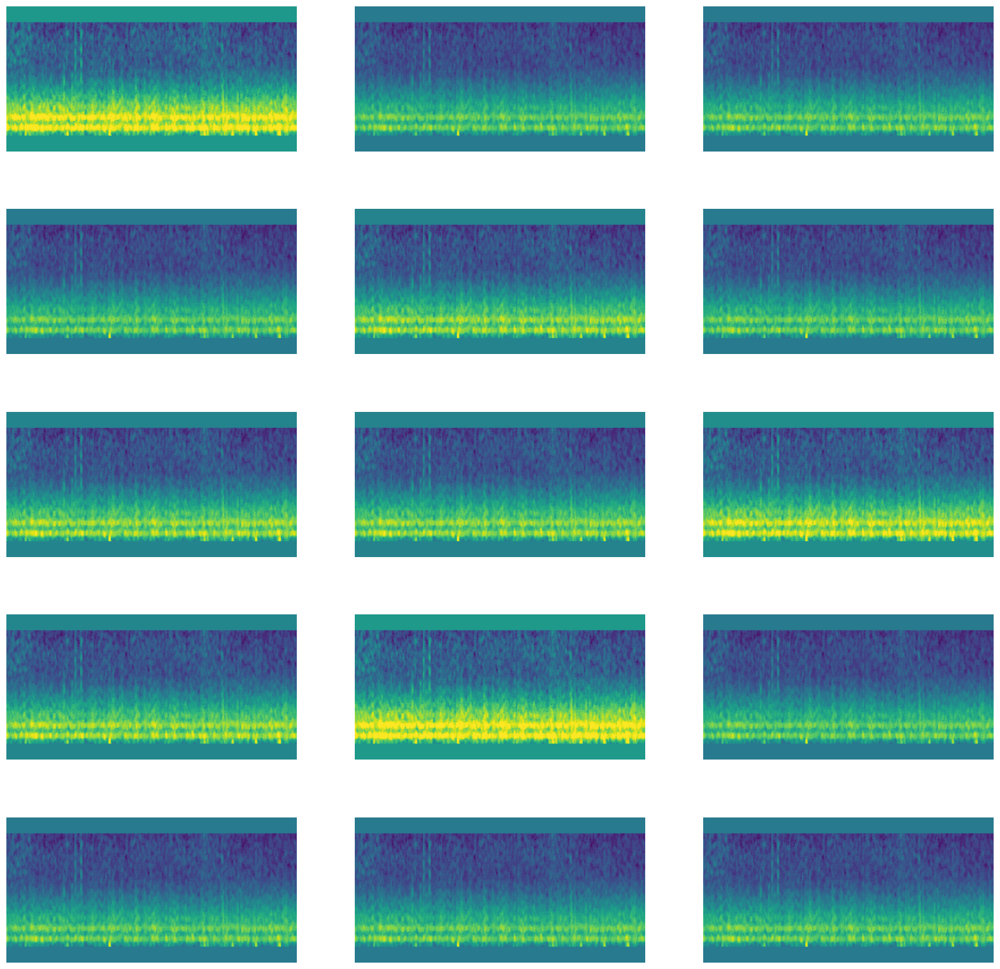

In [787]:
def adjust_contrast(spectrogram, factor=1.5,p=1.0):
    augmenter = albu.RandomBrightnessContrast(brightness_limit=0, contrast_limit=(factor - 1), p=p)
    return augmenter(image=spectrogram)['image']

grid_plot(adjust_contrast,img.numpy())

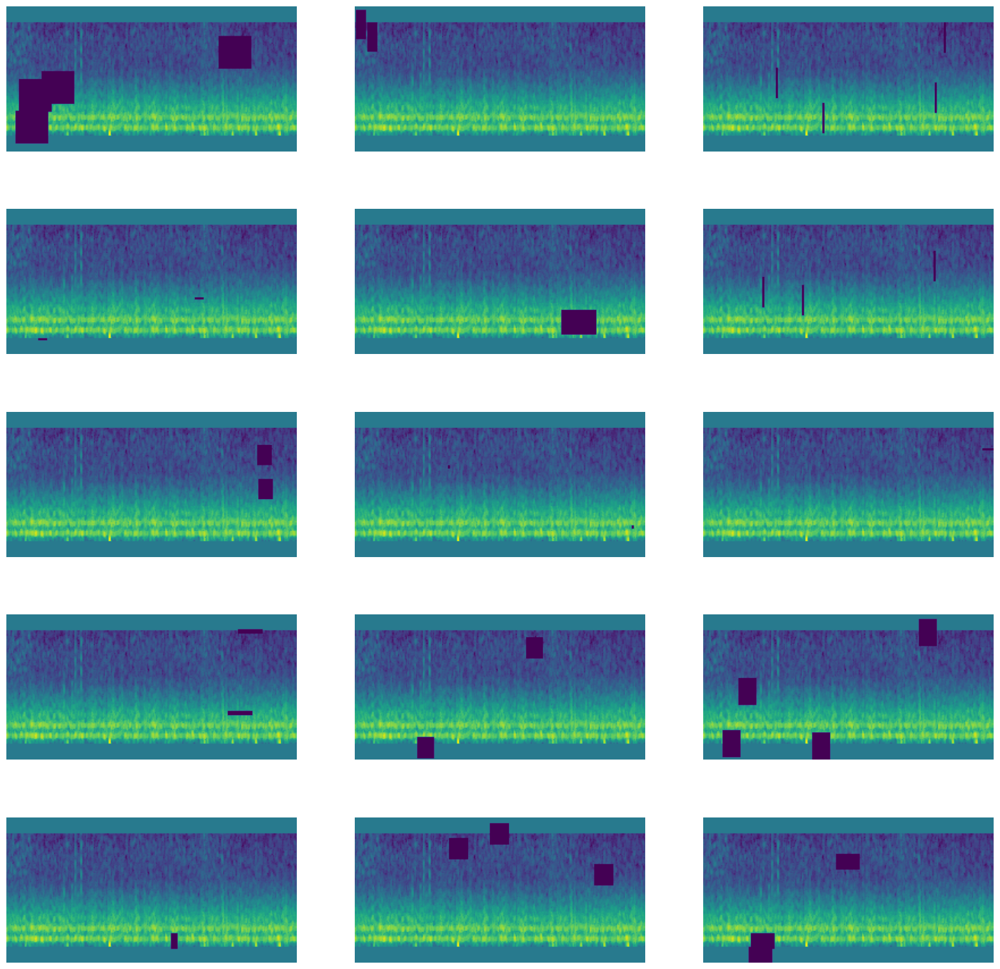

In [788]:
### Cutout

def cutout(spectrogram,max_holes=5,max_height=32,max_width=32,fill_value=0,p=1):
    max_holes = np.random.randint(1,max_holes)
    max_height = np.random.randint(1,max_height)
    max_width = np.random.randint(1,max_width)
    
    return albu.CoarseDropout(max_holes=max_holes,max_height=max_height,max_width=max_width,fill_value=fill_value,p=p)(image = spectrogram)['image']

grid_plot(cutout, img.numpy())

### Dataloader with Data augments

In [789]:
import albumentations as albu
from torch.utils.data import Dataset, DataLoader

TARS = {'Seizure':0, 'LPD':1, 'GPD':2, 'LRDA':3, 'GRDA':4, 'Other':5}
TARS2 = {x:y for y,x in TARS.items()}

In [796]:
class DataGenerator(Dataset):
    'Generates data for Keras'
    def __init__(self, data, shuffle=False, augment=False, mode='train',
                 specs = spectrograms, eeg_specs = all_eegs): 

        self.data = data
        self.augment = augment
        self.mode = mode
        self.specs = specs
        self.eeg_specs = eeg_specs
        
    def __len__(self):
        return len(self.data) 
    
    def __getitem__(self, index):
        'Generate one batch of data'
        X, y = self.__data_generation(index)
        if self.augment: X = self.__random_transform(X) 
        return X, y
                        
    def __data_generation(self, index):
        'Generates data containing batch_size samples' 
        
        X = np.zeros((128,256,8),dtype='float32')
        y = np.zeros((6),dtype='float32')
        img = np.ones((128,256),dtype='float32')
        
        row = self.data.iloc[index]
        if self.mode=='test': 
            r = 0
        else: 
            r = int( (row['min'] + row['max'])//4 )

        for k in range(4):
            # EXTRACT 300 ROWS OF SPECTROGRAM
            img = self.specs[row.spec_id][r:r+300,k*100:(k+1)*100].T

            # LOG TRANSFORM SPECTROGRAM
            img = np.clip(img,np.exp(-4),np.exp(8))
            img = np.log(img)

            # STANDARDIZE PER IMAGE
            ep = 1e-6
            m = np.nanmean(img.flatten())
            s = np.nanstd(img.flatten())
            img = (img-m)/(s+ep)
            img = np.nan_to_num(img, nan=0.0)

            # CROP TO 256 TIME STEPS
            X[14:-14,:,k] = img[:,22:-22] / 2.0

        # EEG SPECTROGRAMS
        img = self.eeg_specs[row.eeg_id]
        X[:,:,4:] = img

        if self.mode!='test':
            y = row[TARGETS]
            
        return X,np.array(y).astype(np.float32)
    
    def __random_transform(self, img):
        img = time_warp(img, p=0.2)
        img = frequency_shift(img, p=0.05)
        img = rotate_spectrogram(img, p=0.05)
        img = horizontal_flip(img, p=0.2)
        img = scale_amplitude(img, p=0.2)
        img = add_noise(img, p=0.2)
        img = random_crop(img, p=0.1)
        img = adjust_contrast(img, p=0.1)
        img = mask_time_frequency(img, p=0.2)
        img = cutout(img, p=0.2)
        return img
            

In [797]:
train_dataset = DataGenerator(train, augment=True)
train_dataloader = DataLoader(train_dataset, batch_size=32, shuffle=False)


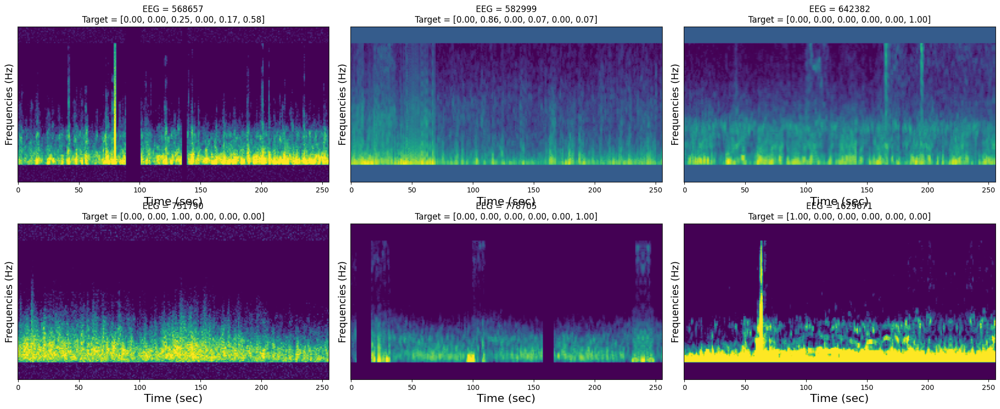

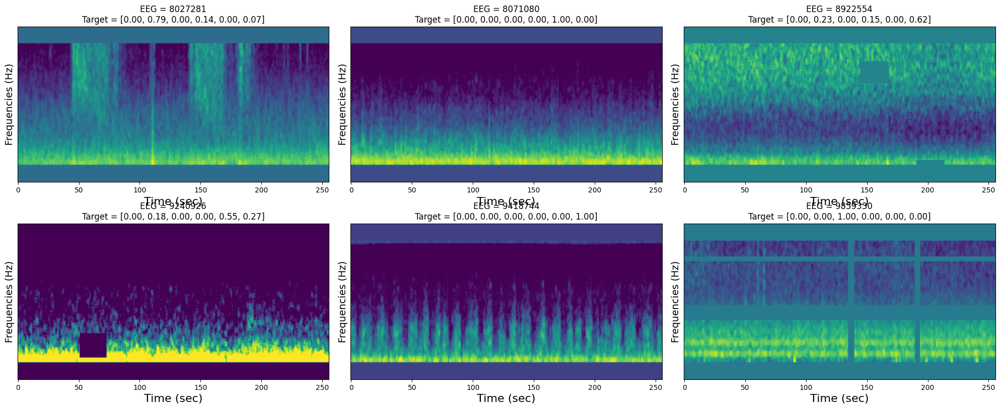

In [802]:
# Constants
ROWS = 2 # Define number of rows here
COLS = 3 # Define number of columns here
BATCHES = 2 # Define number of batches here

# Processing the dataloader
for i, (x, y) in enumerate(train_dataloader):
    if i >= BATCHES:
        break

    # Initialize figure and subplots
    fig, axes = plt.subplots(ROWS, COLS, figsize=(20, 8))
    axes = axes.flatten()  # Flatten for easy indexing

    for j in range(ROWS):
        for k in range(COLS):
            ax = axes[j * COLS + k]

            t = y[j * COLS + k]
            eeg = train.eeg_id.values[i * 32 + j * COLS + k]

            img = x[j * COLS + k, :, :, 0].flip(0)
            mn = img.flatten().min()
            mx = img.flatten().max()
            img = (img - mn) / (mx - mn)

            ax.imshow(img)

            # Format the target string
            tars = f'[{t[0]:0.2f}'
            for s in t[1:]:
                tars += f', {s:0.2f}'
            tars += ']'

            ax.set_title(f'EEG = {eeg}\nTarget = {tars}', size=12)
            ax.set_yticks([])
            ax.set_ylabel('Frequencies (Hz)', size=14)
            ax.set_xlabel('Time (sec)', size=16)

    # Hide any unused subplots
    for ax in axes[len(x):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()